***Imports:***

**os:** Operating system-related functions and operations.

**cv2:** OpenCV library for computer vision tasks.

**numpy as np:** NumPy library for numerical and array operations, aliased as 'np'.

**pandas as pd:** Pandas library for data manipulation and analysis, aliased as 'pd'.
**
random:** Python's built-in random number generator.

**tqdm:** Library for displaying progress bars during loops or tasks.

**seaborn as sns:** Seaborn library for statistical data visualization, aliased as 'sns'.

**matplotlib.pyplot as plt:** Matplotlib library for creating plots and visualizations, aliased as 'plt'.

**%matplotlib inline:** A magic command for Jupyter Notebook to display Matplotlib plots inline.

**torch**: PyTorch library for deep learning.

**torch.nn as nn:** PyTorch's neural network module.

**torch.utils.data import DataLoader:** PyTorch DataLoader class for loading and batching data.

**albumentations as album**: Albumentations library for image augmentation, aliased as 'album'.

In [1]:
import os, cv2
import numpy as np
import pandas as pd
import random, tqdm
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import albumentations as album

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


**1.Package Installation:**

* !pip install -q -U segmentation-models-pytorch albumentations > /dev/null: This command installs or upgrades two Python packages silently (-q) and redirects the output to /dev/null (a null device, discarding any output).
* segmentation-models-pytorch: A Python package for deep learning-based image segmentation models.
* albumentations: A Python package for advanced image augmentation techniques.

**2.Import:**

* import segmentation_models_pytorch as smp: Imports the segmentation_models_pytorch package and aliases it as 'smp'. This package likely contains pre-defined deep learning models for image segmentation tasks.

In [2]:
!pip install -q -U segmentation-models-pytorch albumentations > /dev/null
import segmentation_models_pytorch as smp

### Read Data & Create train / valid splits 📁

**1. Load and Prepare Data:**

* Load metadata from a CSV file in the 'DATA_DIR'.
* Filter for training data and select specific columns.
* Modify image paths by appending 'DATA_DIR'.
* Shuffle the DataFrame.

**2. Train-Validation Split:**

* Create a validation set by randomly selecting 10% of the data.
* Create a training set by excluding validation samples.
* Get the sizes of the training and validation sets.Load and Prepare Data:


In [3]:
DATA_DIR = '../input/deepglobe-road-extraction-dataset'

metadata_df = pd.read_csv(os.path.join(DATA_DIR, 'metadata.csv'))
metadata_df = metadata_df[metadata_df['split']=='train']
metadata_df = metadata_df[['image_id', 'sat_image_path', 'mask_path']]
metadata_df['sat_image_path'] = metadata_df['sat_image_path'].apply(lambda img_pth: os.path.join(DATA_DIR, img_pth))
metadata_df['mask_path'] = metadata_df['mask_path'].apply(lambda img_pth: os.path.join(DATA_DIR, img_pth))
# Shuffle DataFrame
metadata_df = metadata_df.sample(frac=1).reset_index(drop=True)

# Perform 90/10 split for train / val
valid_df = metadata_df.sample(frac=0.1, random_state=42)
train_df = metadata_df.drop(valid_df.index)
len(train_df), len(valid_df)

(5603, 623)

**1. Load and Extract Class Information:**

* Load class information from a CSV file.
* Extract class names and RGB values.

**2. Print Class Information:**

* Display class names and their corresponding RGB values.

In [4]:
class_dict = pd.read_csv(os.path.join(DATA_DIR, 'class_dict.csv'))
# Get class names
class_names = class_dict['name'].tolist()
# Get class RGB values
class_rgb_values = class_dict[['r','g','b']].values.tolist()

print('All dataset classes and their corresponding RGB values in labels:')
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

All dataset classes and their corresponding RGB values in labels:
Class Names:  ['road', 'background']
Class RGB values:  [[255, 255, 255], [0, 0, 0]]


#### Shortlist specific classes to segment

**1. Define Specific Classes:**

* select_classes = ['background', 'road']: Specifies a list of specific classes to select from a dataset with a large number of classes.

**2. Extract RGB Values of Selected Classes:**

* select_class_indices = [class_names.index(cls.lower()) for cls in select_classes]: Finds the indices of the selected classes in the class_names list by converting them to lowercase and using a list comprehension.
* select_class_rgb_values = np.array(class_rgb_values)[select_class_indices]: Extracts the RGB values of the selected classes using the indices found in the previous step and stores them in select_class_rgb_values.

**3. Print Selected Class Information:**

* Displays the names and RGB values of the selected classes using print statements.

In [5]:
# Useful to shortlist specific classes in datasets with large number of classes
select_classes = ['background', 'road']

# Get RGB values of required classes
select_class_indices = [class_names.index(cls.lower()) for cls in select_classes]
select_class_rgb_values =  np.array(class_rgb_values)[select_class_indices]

print('Selected classes and their corresponding RGB values in labels:')
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

Selected classes and their corresponding RGB values in labels:
Class Names:  ['road', 'background']
Class RGB values:  [[255, 255, 255], [0, 0, 0]]


### Helper functions for viz. & one-hot encoding/decoding

1. **visualize(images):**

* Description: Visualizes multiple images in a row.
* Input: Keyword arguments where keys are image names and values are the images.
* Output: Displays the images in a single row using Matplotlib.

2. **one_hot_encode(label, label_values):**

* Description: Converts a segmentation image label array to one-hot format.
* Input:
label: The 2D array segmentation image label.
label_values: List of class labels for one-hot encoding.
* Output: Returns a 2D array with the same dimensions as the input but with depth equal to the number of classes.

3. **reverse_one_hot(image):**

* Description: Transforms a one-hot format image to a 2D array with class labels.
* Input:
image: The one-hot format image.
* Output: Returns a 2D array with the same dimensions as the input but with a single channel where each pixel value represents the classified class key.

4. **colour_code_segmentation(image, label_values):**

* Description: Given a 1-channel array of class keys, color codes the segmentation results.
* Input:
image: Single-channel array where each value represents a class key.
label_values: List of class RGB values.
* Output: Returns a color-coded image for visualization.

In [6]:
# helper function for data visualization
def visualize(**images):
    """
    Plot images in one row
    """
    n_images = len(images)
    plt.figure(figsize=(20,8))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_images, idx + 1)
        plt.xticks([]); 
        plt.yticks([])
        # get title from the parameter names
        plt.title(name.replace('_',' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

# Perform one hot encoding on label
def one_hot_encode(label, label_values):
    """
    Convert a segmentation image label array to one-hot format
    by replacing each pixel value with a vector of length num_classes
    # Arguments
        label: The 2D array segmentation image label
        label_values
        
    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of num_classes
    """
    semantic_map = []
    for colour in label_values:
        equality = np.equal(label, colour)
        class_map = np.all(equality, axis = -1)
        semantic_map.append(class_map)
    semantic_map = np.stack(semantic_map, axis=-1)

    return semantic_map
    
# Perform reverse one-hot-encoding on labels / preds
def reverse_one_hot(image):
    """
    Transform a 2D array in one-hot format (depth is num_classes),
    to a 2D array with only 1 channel, where each pixel value is
    the classified class key.
    # Arguments
        image: The one-hot format image 
        
    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of 1, where each pixel value is the classified 
        class key.
    """
    x = np.argmax(image, axis = -1)
    return x

# Perform colour coding on the reverse-one-hot outputs
def colour_code_segmentation(image, label_values):
    """
    Given a 1-channel array of class keys, colour code the segmentation results.
    # Arguments
        image: single channel array where each value represents the class key.
        label_values

    # Returns
        Colour coded image for segmentation visualization
    """
    colour_codes = np.array(label_values)
    x = colour_codes[image.astype(int)]

    return x



1. **RoadsDataset(torch.utils.data.Dataset):**

* Description: Custom dataset class for the DeepGlobe Road Extraction Challenge, designed to read images, apply augmentation, and preprocessing transformations.
* Args:
df (DataFrame): DataFrame containing image and label paths.
class_rgb_values (list): RGB values of selected classes for segmentation masks.
augmentation (albumentations.Compose): Data transformation pipeline for augmentations.
preprocessing (albumentations.Compose): Data preprocessing pipeline.

2. **__init__(self, df, class_rgb_values=None, augmentation=None, preprocessing=None):**

Description: Initializes the dataset class.
Parameters:
df: DataFrame containing image and label paths.
class_rgb_values: RGB values of selected classes for segmentation masks (optional).
augmentation: Data transformation pipeline for augmentations (optional).
preprocessing: Data preprocessing pipeline (optional).

3. **__getitem__(self, i):**

Description: Retrieves an item (image and mask) from the dataset at index i.
Parameters:
i: Index of the item to retrieve.
Returns: Tuple containing an image and its corresponding mask after one-hot encoding, augmentation, and preprocessing.

4. **__len__(self):**

Description: Returns the length (number of items) in the dataset.
Returns: Length of the dataset, which corresponds to the number of images.
This code defines a custom dataset class for working with image segmentation data, allowing data loading, augmentation, and preprocessing for deep learning tasks such as semantic segmentation.

In [7]:
class RoadsDataset(torch.utils.data.Dataset):

    """DeepGlobe Road Extraction Challenge Dataset. Read images, apply augmentation and preprocessing transformations.
    
    Args:
        df (str): DataFrame containing images / labels paths
        class_rgb_values (list): RGB values of select classes to extract from segmentation mask
        augmentation (albumentations.Compose): data transfromation pipeline 
            (e.g. flip, scale, etc.)
        preprocessing (albumentations.Compose): data preprocessing 
            (e.g. noralization, shape manipulation, etc.)
    
    """
    def __init__(
            self, 
            df,
            class_rgb_values=None, 
            augmentation=None, 
            preprocessing=None,
    ):
        self.image_paths = df['sat_image_path'].tolist()
        self.mask_paths = df['mask_path'].tolist()
        
        self.class_rgb_values = class_rgb_values
        self.augmentation = augmentation
        self.preprocessing = preprocessing
    
    def __getitem__(self, i):
        
        # read images and masks
        image = cv2.cvtColor(cv2.imread(self.image_paths[i]), cv2.COLOR_BGR2RGB)
        mask = cv2.cvtColor(cv2.imread(self.mask_paths[i]), cv2.COLOR_BGR2RGB)
        
        # one-hot-encode the mask
        mask = one_hot_encode(mask, self.class_rgb_values).astype('float')
        
        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
            
        return image, mask
        
    def __len__(self):
        # return length of 
        return len(self.image_paths)

#### Visualize Sample Image and Mask 📈

Create Dataset:

dataset = RoadsDataset(train_df, class_rgb_values=select_class_rgb_values): Initializes a custom dataset (dataset) using the training data (train_df) and the selected class RGB values.
Randomly Select an Item from the Dataset:

random_idx = random.randint(0, len(dataset)-1): Generates a random index within the dataset's length.
image, mask = dataset[2]: Retrieves an image and its corresponding mask from the dataset at the specified index (2 in this case).
Visualize Data:

visualize(...): Calls the visualize function to display images for visualization purposes.
Arguments passed to visualize include:
original_image: The original image.
ground_truth_mask: The color-coded ground truth segmentation mask.
one_hot_encoded_mask: The one-hot encoded segmentation mask.
This code segment demonstrates the creation of a dataset for road segmentation, randomly selecting an example, and visualizing the original image, ground truth mask, and one-hot encoded mask for that example. It's helpful for verifying data and model inputs during development.



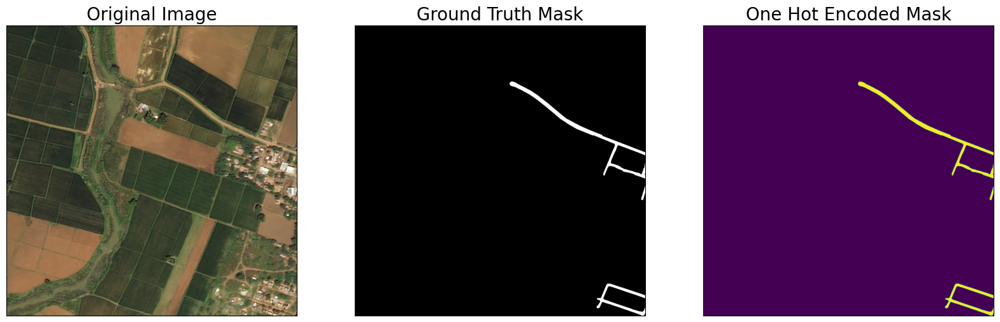

In [8]:
dataset = RoadsDataset(train_df, class_rgb_values=select_class_rgb_values)
random_idx = random.randint(0, len(dataset)-1)
image, mask = dataset[2]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

### Defining Augmentations 🙃

get_training_augmentation():

Description: Returns a data augmentation pipeline for training.
Returns: An augmentation pipeline (albumentations.Compose object) containing horizontal and vertical flips.
to_tensor(x, **kwargs):

Description: Converts input data to a tensor format.
Parameters:
x: Input data to be converted.
Returns: The input data converted to a NumPy array with the shape (channels, height, width) and data type 'float32'.
get_preprocessing(preprocessing_fn=None):

Description: Constructs a data preprocessing transform.
Parameters:
preprocessing_fn (callable): Data normalization function (optional, specific for each pretrained neural network).
Returns: A preprocessing transform (albumentations.Compose object) that applies the specified normalization function (if provided) and converts data to tensors.
These functions are designed to assist in data preparation for deep learning tasks, including augmentations and preprocessing to improve the model's performance and compatibility with different neural network architectures.

In [9]:
def get_training_augmentation():
    train_transform = [
        album.HorizontalFlip(p=0.5),
        album.VerticalFlip(p=0.5),
    ]
    return album.Compose(train_transform)


def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn=None):
    """Construct preprocessing transform    
    Args:
        preprocessing_fn (callable): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose
    """
    _transform = []
    if preprocessing_fn:
        _transform.append(album.Lambda(image=preprocessing_fn))
    _transform.append(album.Lambda(image=to_tensor, mask=to_tensor))
        
    return album.Compose(_transform)

#### Visualize Augmented Images & Masks

Create Augmented Dataset:

augmented_dataset = RoadsDataset(train_df, augmentation=get_training_augmentation(), class_rgb_values=select_class_rgb_values): Initializes a custom dataset (augmented_dataset) for training with data augmentations using the get_training_augmentation() function and selected class RGB values.
Randomly Select an Item from the Augmented Dataset:

random_idx = random.randint(0, len(augmented_dataset)-1): Generates a random index within the augmented dataset's length.
Apply Different Augmentations and Visualize:

A loop iterates three times, and for each iteration, it:
Retrieves an image and its corresponding mask from the augmented dataset at the current index.
Calls the visualize function to display the original image, ground truth mask, and one-hot encoded mask for visualization purposes.
This code segment demonstrates the creation of an augmented dataset for training, random selection of examples, and visualization of images with different augmentations applied. It helps in understanding how data augmentations affect the training data.

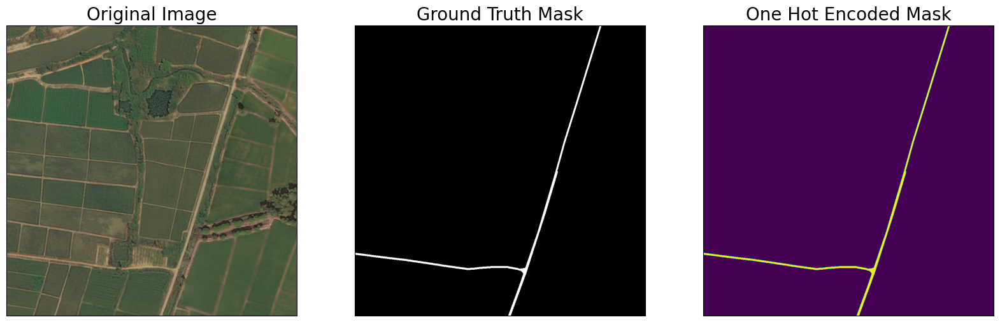

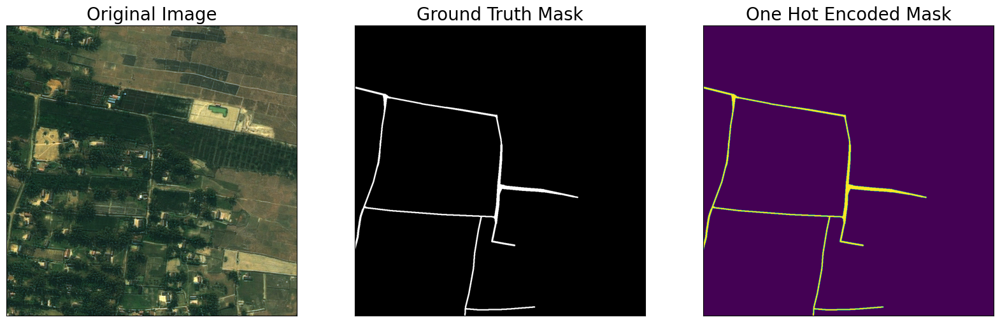

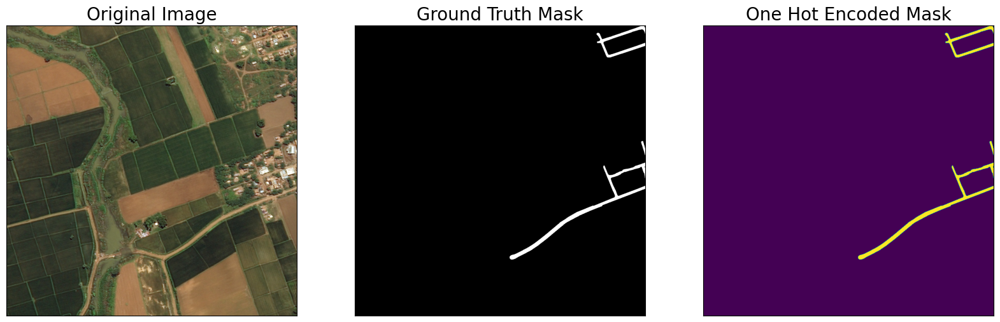

In [10]:
augmented_dataset = RoadsDataset(
    train_df, 
    augmentation=get_training_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

random_idx = random.randint(0, len(augmented_dataset)-1)

# Different augmentations on image/mask pairs
for idx in range(3):
    image, mask = augmented_dataset[idx]
    visualize(
        original_image = image,
        ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
        one_hot_encoded_mask = reverse_one_hot(mask)
    )

## Training DeepLabV3+

<h3><center>DeepLabV3+ Model Architecture</center></h3>
<img src="https://miro.medium.com/max/1000/1*2mYfKnsX1IqCCSItxpXSGA.png" width="750" height="750"/>
<h4></h4>
<h4><center><a href="https://arxiv.org/abs/1802.02611">Image Source: DeepLabV3+ [Liang-Chieh Chen et al.]</a></center></h4>

### Model Definition

Define Model Parameters:

ENCODER = 'resnet50': Specifies the encoder architecture as 'resnet50'.
ENCODER_WEIGHTS = 'imagenet': Specifies using pretrained weights from the ImageNet dataset.
CLASSES = select_classes: Defines the list of classes for the segmentation task.
ACTIVATION = 'sigmoid': Specifies the activation function for the model, which is 'sigmoid' for binary segmentation.
Create Segmentation Model:

model = smp.DeepLabV3Plus(...): Creates a DeepLabV3Plus segmentation model using the specified encoder, pretrained weights, number of classes, and activation function.
Get Preprocessing Function:

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS): Retrieves the preprocessing function for the specified encoder and weights, which is useful for normalizing input data to match the pretraining statistics of the encoder.

In [11]:
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = select_classes
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation

# create segmentation model with pretrained encoder
model = smp.DeepLabV3Plus(
    encoder_name=ENCODER, 
    encoder_weights=ENCODER_WEIGHTS, 
    classes=len(CLASSES), 
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 233MB/s]


#### Get Train / Val DataLoaders

Create Train and Validation Datasets:

train_dataset = RoadsDataset(...): Initializes the training dataset with data augmentation and preprocessing transformations.
valid_dataset = RoadsDataset(...): Initializes the validation dataset with preprocessing transformations.
Create Train and Validation Data Loaders:

train_loader = DataLoader(...): Creates a data loader for the training dataset with a batch size of 4, shuffling the data, and using 4 worker processes for parallel data loading.
valid_loader = DataLoader(...): Creates a data loader for the validation dataset with similar settings but without shuffling.
These code segments prepare the training and v

In [12]:
# Get train and val dataset instances
train_dataset = RoadsDataset(
    train_df, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

valid_dataset = RoadsDataset(
    valid_df, 
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

# Get train and val data loaders
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=4)
valid_loader = DataLoader(valid_dataset, batch_size=4, shuffle=False, num_workers=4)

#### Set Hyperparams

In [13]:
import segmentation_models_pytorch.utils as smp_utils

Set Training Flag and Number of Epochs:

TRAINING = True: Sets the flag to True to indicate that training will be performed.
EPOCHS = 3: Defines the number of training epochs.
Set Device:

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu"): Determines the device for training, prioritizing GPU ('cuda') if available, otherwise using CPU ('cpu').
Define Loss Function:

loss = smp.utils.losses.DiceLoss(): Initializes the Dice loss function for training.
Define Metrics:

metrics: Defines a list of evaluation metrics, including Intersection over Union (IoU) with a threshold of 0.5.
Define Optimizer:

optimizer: Configures the Adam optimizer with a specific learning rate for model parameter updates.
Define Learning Rate Scheduler (Not Used):

lr_scheduler: Initializes a learning rate scheduler (CosineAnnealingWarmRestarts), but it's not used in this notebook.
Load Pretrained Model Checkpoint (If Present):

Checks if a pretrained model checkpoint exists in the specified location.
If a checkpoint is found, it loads the pretrained model onto the selected device (CPU or GPU).

In [14]:
# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set num of epochs
EPOCHS = 3

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# define loss function
loss = smp.utils.losses.DiceLoss()

# define metrics
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]

# define optimizer
optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.00008),
])

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

# load best saved model checkpoint from previous commit (if present)
if os.path.exists('../input/road-extraction-from-satellite-images-deeplabv3/best_model.pth'):
    model = torch.load('../input/road-extraction-from-satellite-images-deeplabv3/best_model.pth', map_location=DEVICE)
    print('Loaded pre-trained DeepLabV3+ model!')

Create Training and Validation Epochs:

train_epoch: Initializes a training epoch object using the smp.utils.train.TrainEpoch class.
Parameters include the model, loss function, evaluation metrics, optimizer, device, and verbose setting.
valid_epoch: Initializes a validation epoch object using the smp.utils.train.ValidEpoch class.

Parameters include the model, loss function, evaluation metrics, device, and verbose setting.

In [15]:
train_epoch = smp.utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

### Training DeepLabV3+

%%time:

This is a Jupyter Notebook magic command used to measure the execution time of the following code block.
Training Loop (Conditional on TRAINING Flag):

If TRAINING is set to True, the following steps are performed for a specified number of epochs (EPOCHS):
Training and validation are performed for each epoch using the training and validation data loaders.
Training logs and validation logs are recorded for each epoch.
If the validation Intersection over Union (IoU) score improves and becomes the best so far, the model is saved as 'best_model.pth'.

In [16]:
%%time

if TRAINING:

    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, './best_model.pth')
            print('Model saved!')


Epoch: 0
valid: 100%|██████████| 156/156 [01:40<00:00,  1.56it/s, dice_loss - 0.03781, iou_score - 0.9391]
Model saved!

Epoch: 1
valid: 100%|██████████| 156/156 [01:40<00:00,  1.55it/s, dice_loss - 0.02592, iou_score - 0.9535]
Model saved!

Epoch: 2
valid: 100%|██████████| 156/156 [01:39<00:00,  1.57it/s, dice_loss - 0.02409, iou_score - 0.955] 
Model saved!
CPU times: user 1h 34min 45s, sys: 3min 3s, total: 1h 37min 49s
Wall time: 1h 45min 3s


### Prediction on Test Data

Load Best Saved Model Checkpoint from the Current Run:

Checks if a model checkpoint file named 'best_model.pth' exists in the current directory.
If the checkpoint file is found, it loads the model checkpoint onto the specified device (CPU or GPU).
Prints a message indicating that the model was loaded from the current run.
Load Best Saved Model Checkpoint from a Previous Commit (if Present):

If the checkpoint file is not found in the current directory, it checks if a model checkpoint file with the same name exists in a previous commit directory.
If a checkpoint is found in a previous commit, it loads that model checkpoint onto the specified device.
Prints a message indicating that the model was loaded from a previous commit.

In [17]:
# load best saved model checkpoint from the current run
if os.path.exists('./best_model.pth'):
    best_model = torch.load('./best_model.pth', map_location=DEVICE)
    print('Loaded DeepLabV3+ model from this run.')

# load best saved model checkpoint from previous commit (if present)
elif os.path.exists('../input/road-extraction-from-satellite-images-deeplabv3/best_model.pth'):
    best_model = torch.load('../input/road-extraction-from-satellite-images-deeplabv3/best_model.pth', map_location=DEVICE)
    print('Loaded DeepLabV3+ model from a previous commit.')

Loaded DeepLabV3+ model from this run.


Create Test DataLoader for Model Inference:

test_dataset: Initializes a test dataset using validation data with preprocessing operations, including converting data to tensors.
test_dataloader: Creates a test data loader for model inference using the test_dataset.
Create Test Dataset for Visualization (Without Augmentations):

test_dataset_vis: Initializes a test dataset for visualization purposes using validation data, but without preprocessing augmentations and transformations.
Randomly Select a Test Image/Mask:

Generates a random index within the length of the visualization test dataset.
Retrieves an image and its corresponding mask from the test dataset at the random index.
Visualize Test Image and Masks:

Calls the visualize function to display the original image, ground truth mask, and one-hot encoded mask for visualization purposes.
This code prepares a test dataset and data loader for model inference and visualization, allowing you to visualize the original image and masks of a random test example.

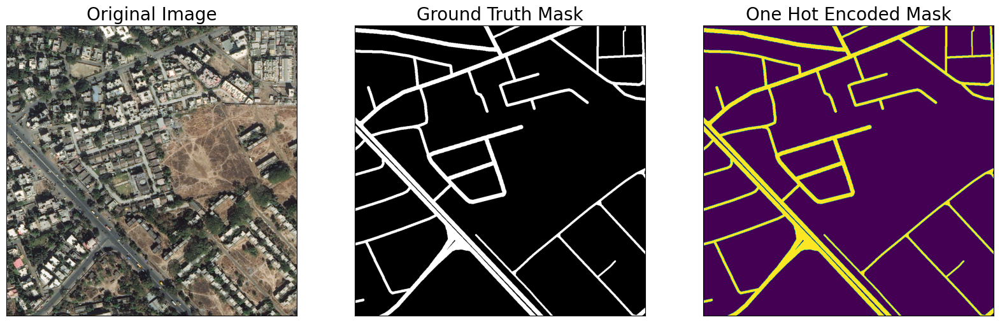

In [18]:
# create test dataloader to be used with DeepLabV3+ model (with preprocessing operation: to_tensor(...))
test_dataset = RoadsDataset(
    valid_df, 
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

test_dataloader = DataLoader(test_dataset)

# test dataset for visualization (without preprocessing augmentations & transformations)
test_dataset_vis = RoadsDataset(
    valid_df,
    class_rgb_values=select_class_rgb_values,
)

# get a random test image/mask index
random_idx = random.randint(0, len(test_dataset_vis)-1)
image, mask = test_dataset_vis[random_idx]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)


In [19]:
sample_preds_folder = 'sample_predictions/'
if not os.path.exists(sample_preds_folder):
    os.makedirs(sample_preds_folder)

Loop Through Test Examples (50 in this case):

For each test example at index idx, the following steps are performed:
Retrieve the test image (image) and ground truth mask (gt_mask) from the test dataset.
Convert the test image to a tensor and move it to the specified device (DEVICE).
Use the best_model to predict the segmentation mask (pred_mask) for the test image.
Convert the predicted mask from the CHW format to the HWC format.
Extract the prediction channel corresponding to the 'road' class to create a road heatmap (pred_road_heatmap).
Convert both the ground truth and predicted masks to color-coded visualizations.
Save the visualization (original image, ground truth mask, and predicted mask) as an image file.
Visualize Test Images and Masks:

Inside the loop, the visualize function is called to display:
The original image.
The ground truth mask.
The predicted mask.
The road heatmap.

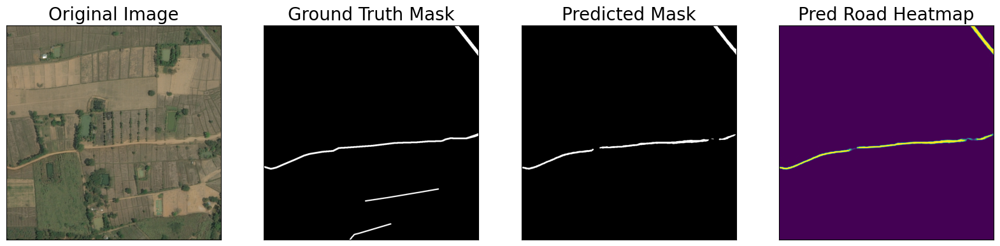

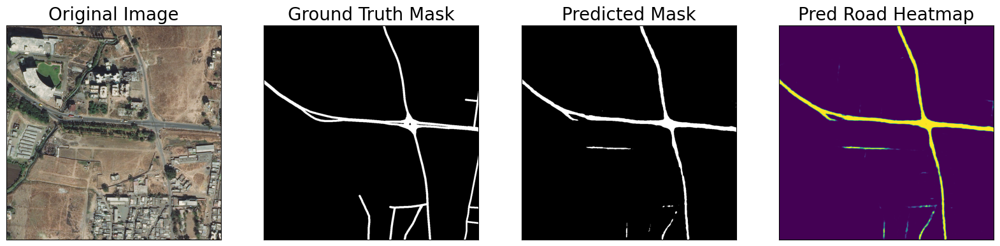

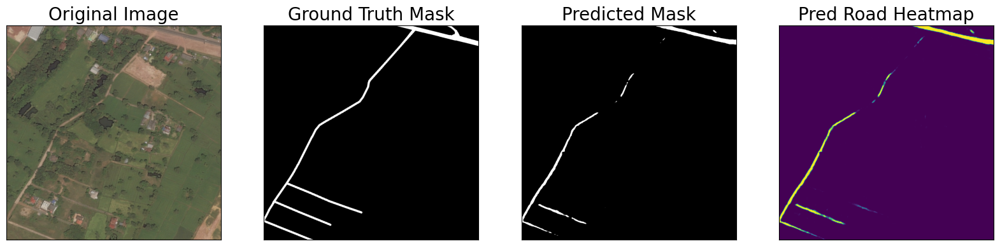

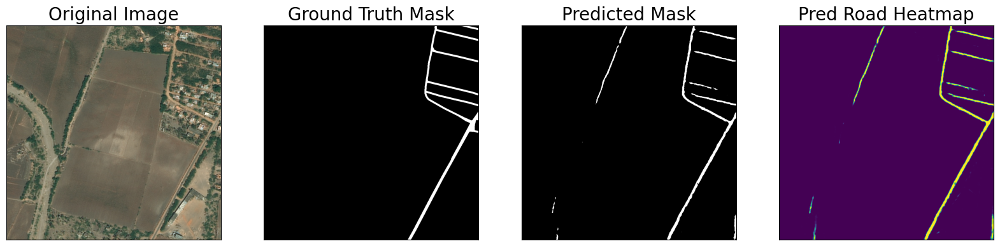

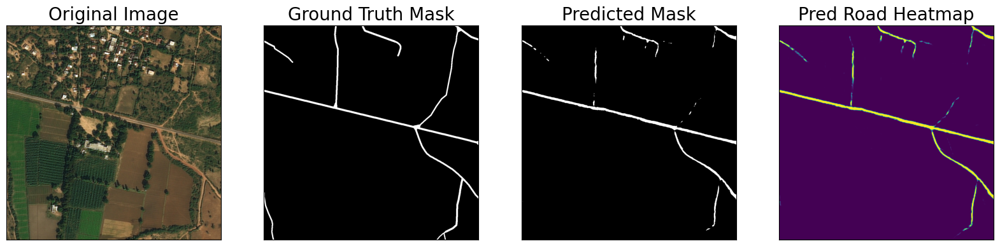

...

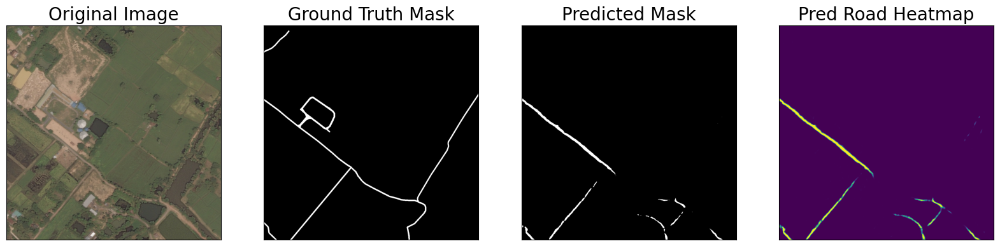

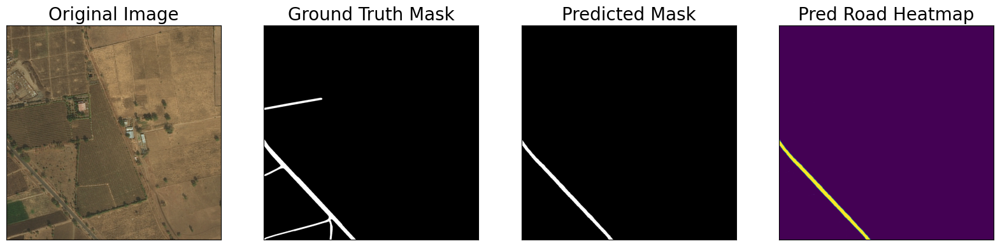

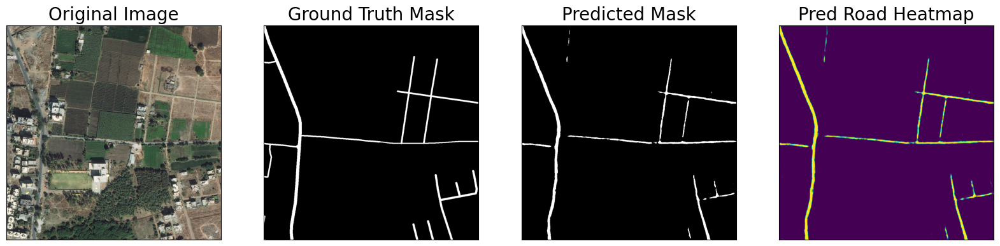

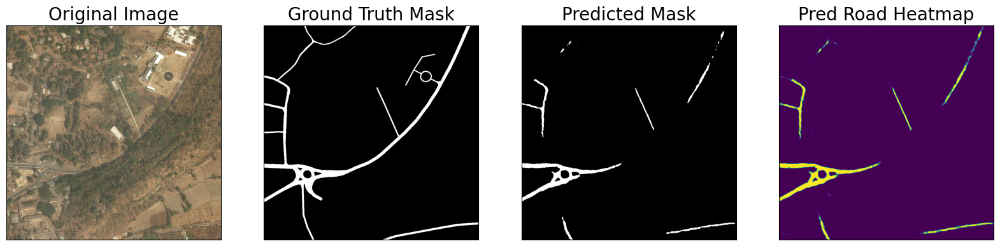

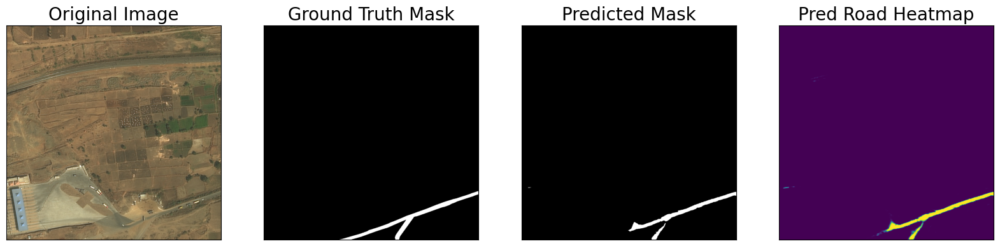

In [20]:
for idx in range(50):

    image, gt_mask = test_dataset[idx]
    image_vis = test_dataset_vis[idx][0].astype('uint8')
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze().cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    pred_mask = np.transpose(pred_mask,(1,2,0))
    # Get prediction channel corresponding to foreground
    pred_road_heatmap = pred_mask[:,:,select_classes.index('road')]
    pred_mask = colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values)
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = np.transpose(gt_mask,(1,2,0))
    gt_mask = colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values)
    cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])
    
    visualize(
        original_image = image_vis,
        ground_truth_mask = gt_mask,
        predicted_mask = pred_mask,
        pred_road_heatmap = pred_road_heatmap
    )

### Model Evaluation on Test Dataset

Create a Test Epoch:

test_epoch: Initializes a validation epoch object (ValidEpoch) for testing on the test dataset.
Parameters include the model, loss function, evaluation metrics, device, and verbose setting.
Run Testing on Test DataLoader:

valid_logs = test_epoch.run(test_dataloader): Performs testing on the test dataset using the specified test data loader.
Calculates and stores validation logs, including the IoU score and Dice loss.
Print Evaluation Results:

print("Evaluation on Test Data: "): Displays a message indicating that evaluation results on the test data will be printed.
Prints the mean IoU score and mean Dice loss from the testing.

In [21]:
test_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

valid_logs = test_epoch.run(test_dataloader)
print("Evaluation on Test Data: ")
print(f"Mean IoU Score: {valid_logs['iou_score']:.4f}")
print(f"Mean Dice Loss: {valid_logs['dice_loss']:.4f}")

valid: 100%|██████████| 623/623 [02:31<00:00,  4.10it/s, dice_loss - 0.02409, iou_score - 0.9557]
Evaluation on Test Data: 
Mean IoU Score: 0.9557
Mean Dice Loss: 0.0241


### Plot Dice Loss & IoU Metric for Train vs. Val

In [22]:
train_logs_df = pd.DataFrame(train_logs_list)
valid_logs_df = pd.DataFrame(valid_logs_list)
train_logs_df.T

,0,1,2
dice_loss,0.087083,0.030793,0.025497
iou_score,0.913126,0.947500,0.953307


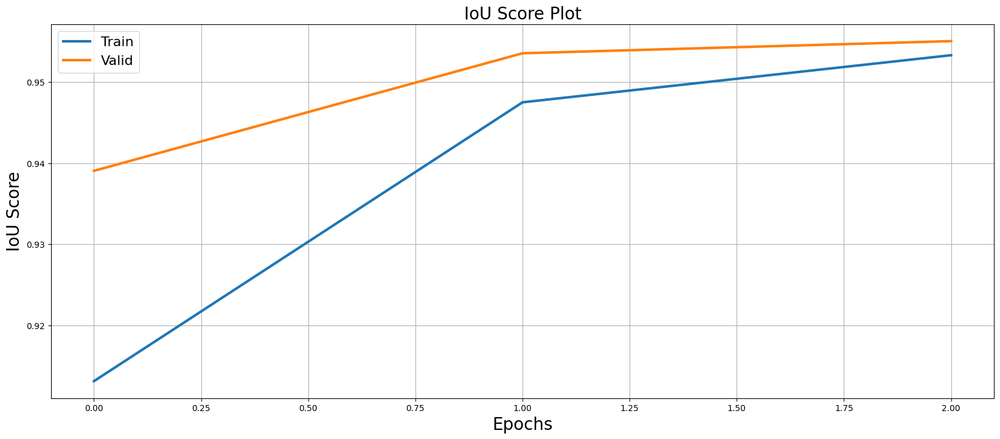

In [23]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.iou_score.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.iou_score.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('IoU Score', fontsize=20)
plt.title('IoU Score Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('iou_score_plot.png')
plt.show()

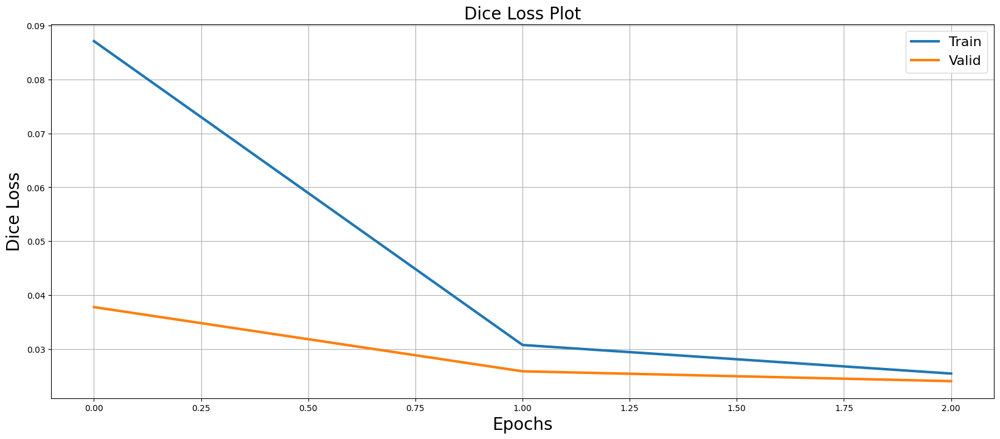

In [24]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.dice_loss.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.dice_loss.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Dice Loss', fontsize=20)
plt.title('Dice Loss Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('dice_loss_plot.png')
plt.show()